#### Importing all the required **Python** and **R** libraries 

In [1]:
import pandas as pd
import scanpy as sc
import warnings
import scarches as sca
warnings.filterwarnings("ignore")

import decoupler as dc

import sys
sys.path.append('../scripts')
%load_ext autoreload
%autoreload 2
from sklearn_ann.kneighbors.annoy import AnnoyTransformer
#%load_ext lab_black

/home/daniele/miniconda3/envs/scmouse_atlas/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
 captum (see https://github.com/pytorch/captum).


In [2]:
sc.set_figure_params(frameon=False)
sc.settings.figdir = '/home/daniele/Code/scmouse_atlas/reports/figures/'

In [2]:
adata = sc.read_h5ad('/mnt/storage/Daniele/atlases/mouse/06_mouse_inhouse_integrated_scanvi.h5ad')

In [3]:
sc.pp.neighbors(adata, use_rep = 'X_scANVI', transformer=AnnoyTransformer(30))

In [4]:
sc.tl.umap(adata, min_dist=0.2)

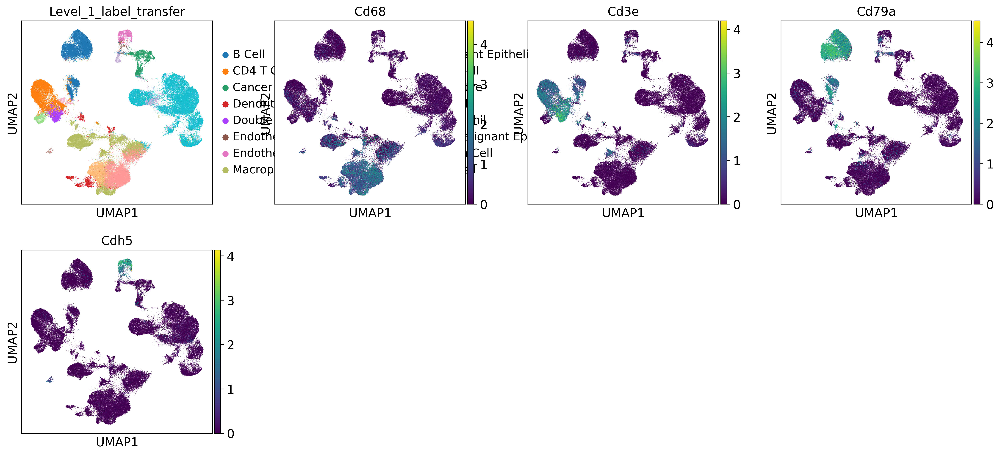

In [5]:
sc.pl.umap(adata, color = ['Level_1_label_transfer', 'Cd68', 'Cd3e', 'Cd79a','Cdh5'], layer='log_norm')

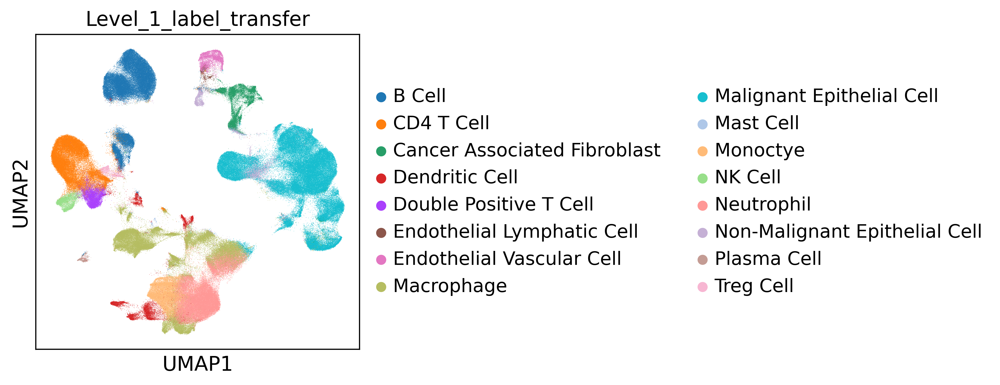

In [6]:
sc.pl.umap(adata, color = ['Level_1_label_transfer'])

In [7]:
sc.tl.leiden(adata, resolution=1, flavor='igraph', key_added='leiden_1.0')

In [61]:
sc.tl.rank_genes_groups(adata, groupby='leiden_1.0', layer='log_norm')
sc.tl.dendrogram(adata, groupby='leiden_1.0', use_rep='X_scANVI')
sc.pl.rank_genes_groups_dotplot(adata, n_genes=5, values_to_plot='logfoldchanges', vmin=-5, vmax=5, min_logfoldchange=2, cmap='coolwarm', dendrogram=True)

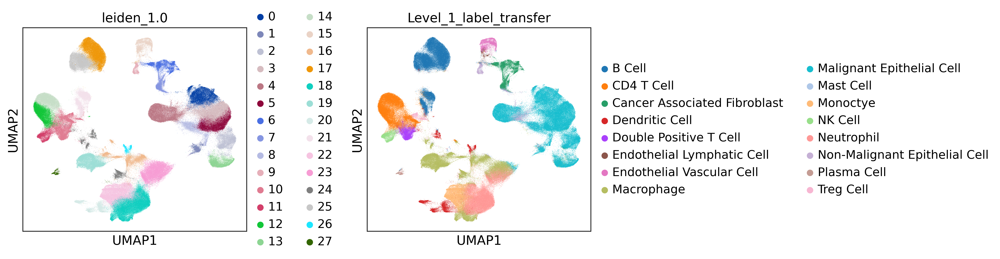

In [9]:
sc.pl.umap(adata, color = ['leiden_1.0', 'Level_1_label_transfer'], layer = 'log_norm', wspace=.4)

In [11]:
level_1_markers = {
    "CAF": ["Acta2", "Tagln", "Myh11", "Cnn1", "Myl9", "Pdgfra"],
    "Pancreatic stellate cells (PSC)": ["Rgs5", "Des", "Acta2", "Lrat", "Pdgfrb"],
    "B cell": ["Cd19", "Cd79a", "Ms4a1", "Cd22", "Ighm"],
    "Plasma cell": ["Ighg1", "Igha", "Sdc1", "Xbp1", "Prdm1"],
    "CD4 T cell": ["Cd3e", "Cd4", "Il7r", "Tcf7", "Lef1"],
    "CD8 T cell": ["Cd3e", "Cd8a", "Gzma", "Gzmb", "Ccl5"],
    "Treg": ["Foxp3", "Il2ra", "Ctla4", "Ikzf2", "Tnfrsf18"],
    "NK cell": ["Ncr1", "Nkg7", "Klrb1c", "Gzmb", "Prf1"],
    "Neutrophil": ["S100a8", "S100a9", "Elane", "Mpo", "Ly6g"],
    "Macrophage": ["Cx3cr1","Adgre1", "Cd68", "Mrc1", "C1qa", "Aif1"],
    "Monocyte": ["Ly6c2", "Ccr2", "Cd14", "Fcgr1", "Trem1"],
    "Mast": ["Kit", "Mcpt4", "Cma1", "Tpsb2", "Hdc"],
    "Dendritic": ["Itgax", "Zbtb46", "Flt3", "Xcr1", "Cd209a"],
    "Endocrine pancreas": ["Neurog3", "Ins2", "Gcg", "Sst", "Ppy"],
    "Endothelial": ["Pecam1", "Cdh5", "Vwf", "Kdr", "Nos3"],
    "Vascular endothelial cells": ["Pecam1", "Cdh5", "Kdr", "Eng", "Nos3"],
    "Lymphatic endothelial cells": ["Prox1", "Lyve1", "Pdpn", "Flt4", "Mmrn1"]
}


In [13]:
sc.tl.dendrogram(adata, groupby='leiden_1.0', use_rep='X_scANVI')
sc.pl.dotplot(adata, var_names=level_1_markers, groupby='leiden_1.0', use_raw=False, layer='log_norm', dendrogram=True)

categories: 0, 1, 2, etc.
var_group_labels: CAF, Pancreatic stellate cells (PSC), B cell, etc.


In [ ]:
anno = {
    "0": "",
    "1": "",
    "2": "",
    "3": "",
    "4": "",
    "5": "",
    "6": "",
    "7": "",
    "8": "",
    "9": "",
    "10": "",
    "11": "",
    "12": "",
    "13": "",
    "14": "",
    "15": "",
    "16": "",
    "17": "",
    "18": "",
    "19": "",
    "20": "",
    "21": "",
    "22": "",
    "23": "",
    "24": "",
    "25": "",
    "26": "",
    "27": "",
    "28": "",
    "29": "",
}

In [68]:
adata.obs['Level_1_refined'] = adata.obs['leiden_1.0'].map(anno).astype('category')

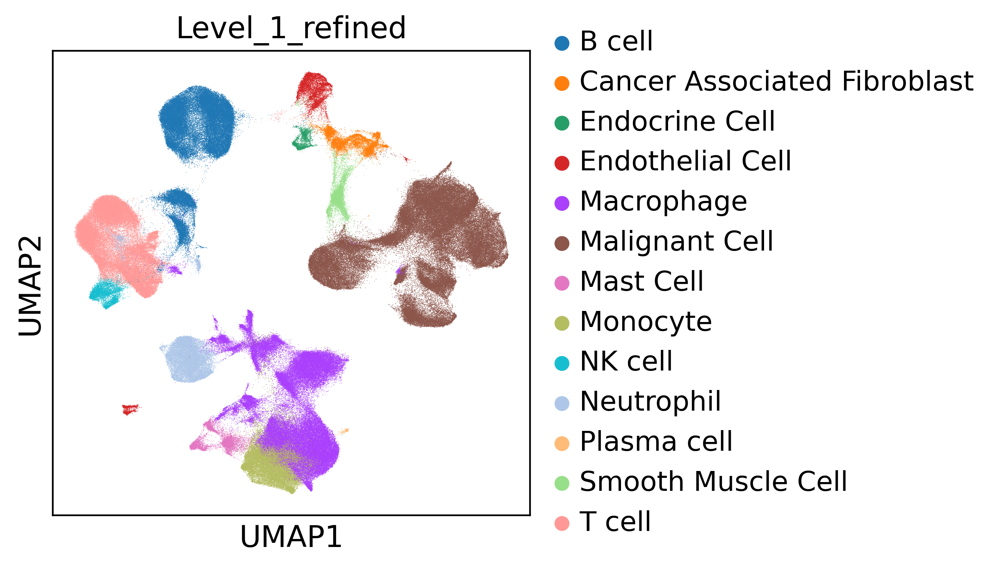

In [70]:
sc.pl.umap(adata, color = ['Level_1_refined'])

In [71]:
adata.write('/mnt/storage/Daniele/atlases/mouse/07_mouse_inhouse_integrated_scanvi_refined.h5ad')